# LightGlue Demo


In [1]:
from lightglue import LightGlue, SuperPoint, DISK
from lightglue.utils import load_image, rbd
from lightglue import viz2d
import torch
import os
import numpy as np
import itertools

torch.set_grad_enabled(False)


## Load extractor and matcher module

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # 'mps', 'cpu'
print(f"Using device: {device}")

Using device: cpu


In [3]:
# DEFAULT SETTINGS
extractor = SuperPoint(max_num_keypoints=2048).eval().to(device)  # load the extractor
matcher = LightGlue(features="superpoint", max_layers=12).eval().to(device)

### Settings Group 1

In [4]:
# MATCHER & EXTRACTOR for GROUP 1
params_extractor = {
    "max_keypoints": 2048,
    # "nms_radius": 4,
    # "keypoint_threshold": 0.015,
}

params_matcher = {
    "features": "superpoint", 
    # "max_distance": 0.7,
    # "max_num_matches": 100,
    # "confidence_threshold": 0.8
    "max_layers": 12
}

extractor_g1   =   SuperPoint(**params_extractor).eval().to(device)
matcher_g1     =   LightGlue(**params_matcher).eval().to(device)

print("Extractor Grupo 1:", params_extractor)
print("Matcher Grupo 1:", params_matcher)

Extractor Grupo 1: {'max_keypoints': 2048}
Matcher Grupo 1: {'features': 'superpoint', 'max_layers': 12}


### Settings Group 2

In [5]:
# MATCHER & EXTRACTOR for GROUP 2
params_extractor = {
    "max_keypoints": 2048,
    # "nms_radius": 4,
    # "keypoint_threshold": 0.015,
}

params_matcher = {
    "features": "superpoint", 
    # "max_distance": 0.7,
    # "max_num_matches": 100,
    # "confidence_threshold": 0.8
    "max_layers": 12
}

extractor_g2   =   SuperPoint(**params_extractor).eval().to(device)
matcher_g2     =   LightGlue(**params_matcher).eval().to(device)

print("Extractor Grupo 2:", params_extractor)
print("Matcher Grupo 2:", params_matcher)

Extractor Grupo 2: {'max_keypoints': 2048}
Matcher Grupo 2: {'features': 'superpoint', 'max_layers': 12}


### Settings Group 3

In [6]:
# MATCHER & EXTRACTOR for GROUP 3
params_extractor = {
    "max_keypoints": 2048,
    # "nms_radius": 4,
    # "keypoint_threshold": 0.015,
}

params_matcher = {
    "features": "superpoint", 
    # "max_distance": 0.7,
    # "max_num_matches": 100,
    # "confidence_threshold": 0.8
    "max_layers": 12
}

extractor_g3   =   SuperPoint(**params_extractor).eval().to(device)
matcher_g3     =   LightGlue(**params_matcher).eval().to(device)

print("Extractor Grupo 3:", params_extractor)
print("Matcher Grupo 3:", params_matcher)

Extractor Grupo 3: {'max_keypoints': 2048}
Matcher Grupo 3: {'features': 'superpoint', 'max_layers': 12}


## Original - Group 1

Procesando imágenes en: ./Group1
Procesando: Img14_Try1_12M.jpg
Resultados guardados en: ./output_npz/Group1_OUT/Img14_Try1_12M_matches.npz
Procesando: Img02_Try1_12M.jpg
Resultados guardados en: ./output_npz/Group1_OUT/Img02_Try1_12M_matches.npz
Procesando: Img13_Try1_12M.jpg
Resultados guardados en: ./output_npz/Group1_OUT/Img13_Try1_12M_matches.npz
Procesando: Img25_Try1_12M.jpg
Resultados guardados en: ./output_npz/Group1_OUT/Img25_Try1_12M_matches.npz
Procesamiento completo.


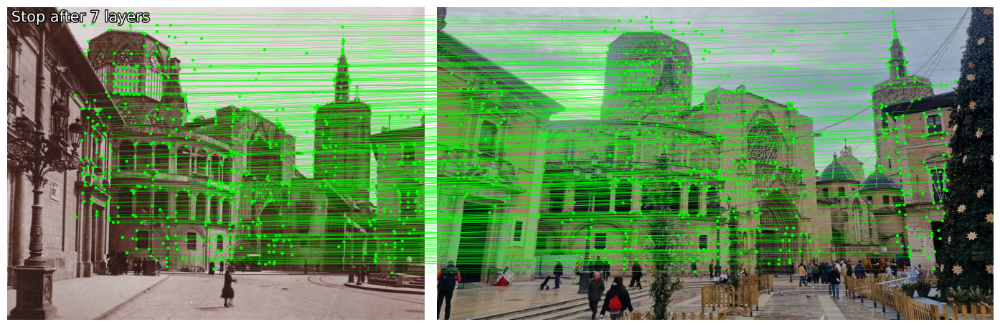

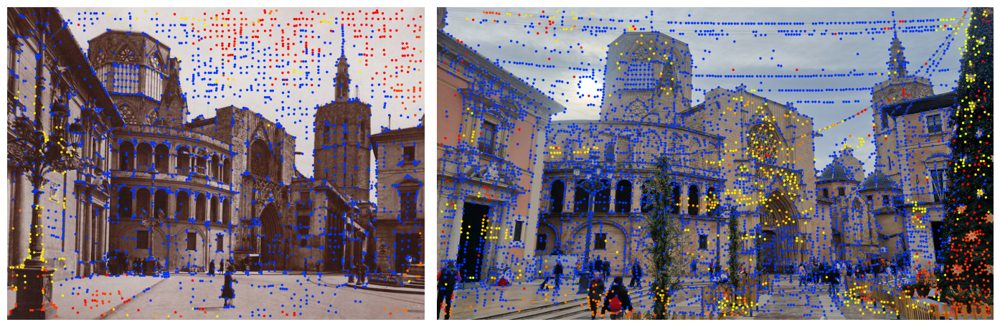

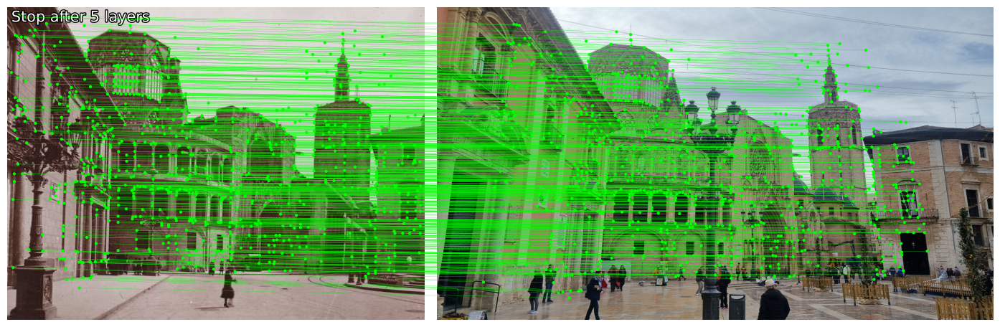

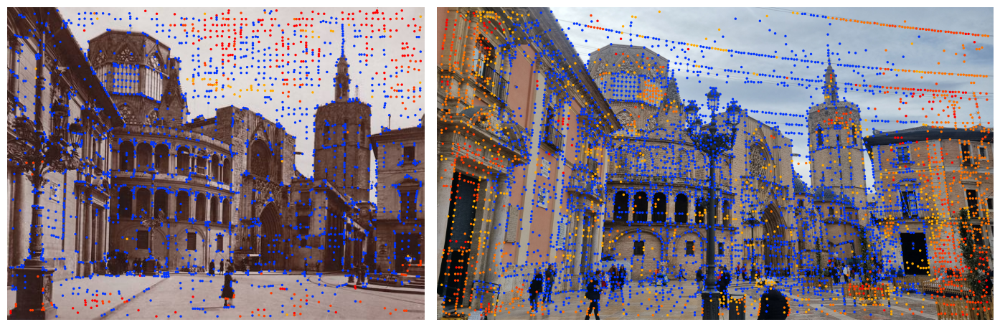

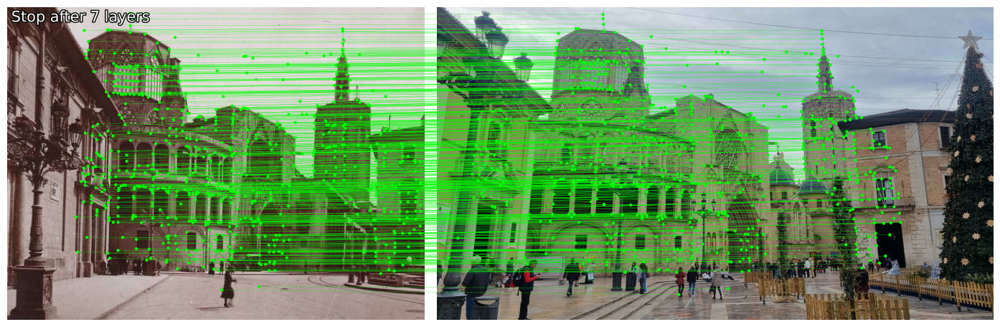

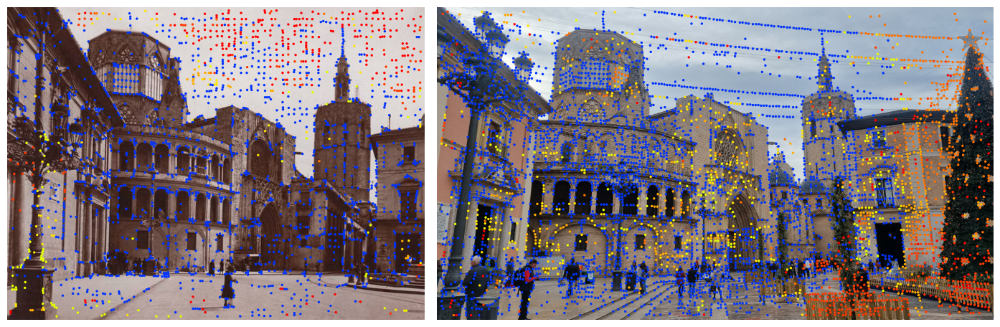

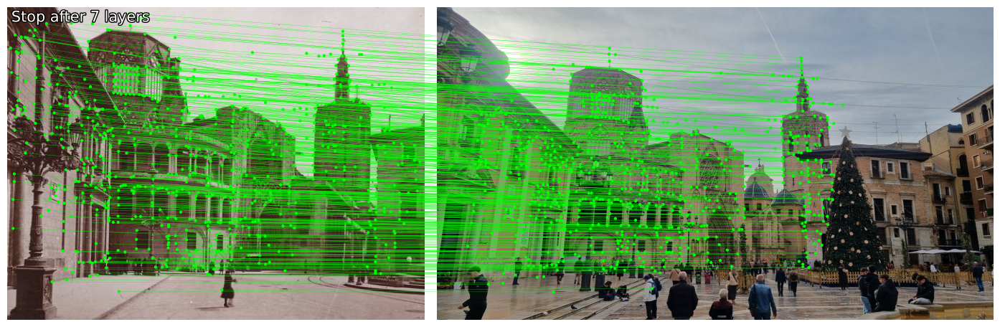

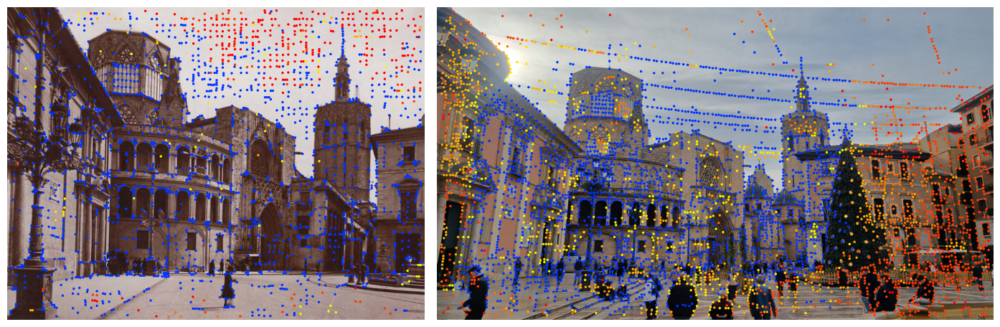

In [ ]:
path_group = "./Group1"
output_path = "./matches_results/Original_Group1"  # Carpeta donde guardar los resultados
os.makedirs(output_path, exist_ok=True)

save_files_flag = True

print("Procesando imágenes en:", path_group)

# Procesar cada imagen en Group1
for filename in os.listdir(path_group):
    if filename.endswith((".jpg", ".png")):  # Ajusta según el formato de tus imágenes
        print("Procesando:", filename)
        
        # Cargar imágenes
        image0 = load_image("../original.jpg")  # Imagen original
        image1 = load_image(os.path.join(path_group, filename))  # Imagen del grupo

        # Extraer características con el extractor
        feats0 = extractor_g1.extract(image0.to(device))
        feats1 = extractor_g1.extract(image1.to(device))
        matches01 = matcher_g1({"image0": feats0, "image1": feats1})
        feats0, feats1, matches01 = [
            rbd(x) for x in [feats0, feats1, matches01]
        ]  # remove batch dimension

        # Extraer keypoints, matches y puntuaciones
        kpts0, kpts1 = feats0["keypoints"], feats1["keypoints"]  # Keypoints de ambas imágenes
        matches = matches01["matches"]  # Matches (índices de keypoints emparejados)
        scores = matches01["scores"]  # Confianza asociada a cada match

        if save_files_flag:
            # Guardar resultados en formato .npz
            output_file = os.path.join(output_path, f"original_vs_{filename.split('.')[0]}_matches.npz")
            np.savez(
                output_file,
                keypoints0=kpts0,  # Keypoints de la imagen original
                keypoints1=kpts1,  # Keypoints de la imagen procesada
                matches=matches,   # Matches (índices emparejados)
                scores=scores      # Puntuaciones asociadas a los matches
            )
            print(f"Resultados guardados en: {output_file}")

        # Visualización opcional (puedes mantenerla o comentarla si no es necesaria)
        m_kpts0, m_kpts1 = kpts0[matches[..., 0]], kpts1[matches[..., 1]]
        axes = viz2d.plot_images([image0, image1])
        viz2d.plot_matches(m_kpts0, m_kpts1, color="lime", lw=0.2)
        viz2d.add_text(0, f'Stop after {matches01["stop"]} layers')

        kpc0, kpc1 = viz2d.cm_prune(matches01["prune0"]), viz2d.cm_prune(matches01["prune1"])
        viz2d.plot_images([image0, image1])
        viz2d.plot_keypoints([kpts0, kpts1], colors=[kpc0, kpc1], ps=6)

print("Procesamiento completo.")

    

Procesando: Img14_Try1_12M.jpg vs Img02_Try1_12M.jpg
Resultados guardados en: ./matches_results/Group1_Group1/Img14_Try1_12M_vs_Img02_Try1_12M_matches.npz
Visualizando matches para: Img14_Try1_12M.jpg vs Img02_Try1_12M.jpg
Procesando: Img14_Try1_12M.jpg vs Img13_Try1_12M.jpg
Resultados guardados en: ./matches_results/Group1_Group1/Img14_Try1_12M_vs_Img13_Try1_12M_matches.npz
Visualizando matches para: Img14_Try1_12M.jpg vs Img13_Try1_12M.jpg
Procesando: Img14_Try1_12M.jpg vs Img25_Try1_12M.jpg
Resultados guardados en: ./matches_results/Group1_Group1/Img14_Try1_12M_vs_Img25_Try1_12M_matches.npz
Visualizando matches para: Img14_Try1_12M.jpg vs Img25_Try1_12M.jpg
Procesando: Img02_Try1_12M.jpg vs Img13_Try1_12M.jpg
Resultados guardados en: ./matches_results/Group1_Group1/Img02_Try1_12M_vs_Img13_Try1_12M_matches.npz
Visualizando matches para: Img02_Try1_12M.jpg vs Img13_Try1_12M.jpg
Procesando: Img02_Try1_12M.jpg vs Img25_Try1_12M.jpg
Resultados guardados en: ./matches_results/Group1_Group

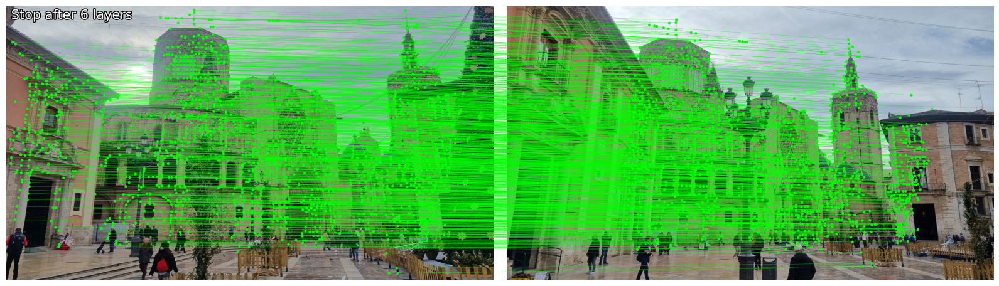

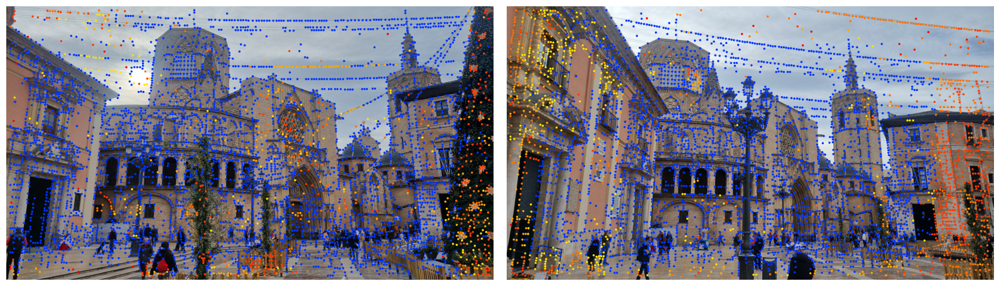

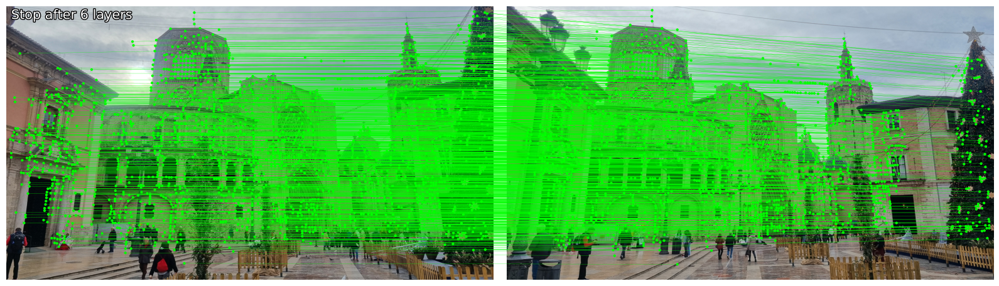

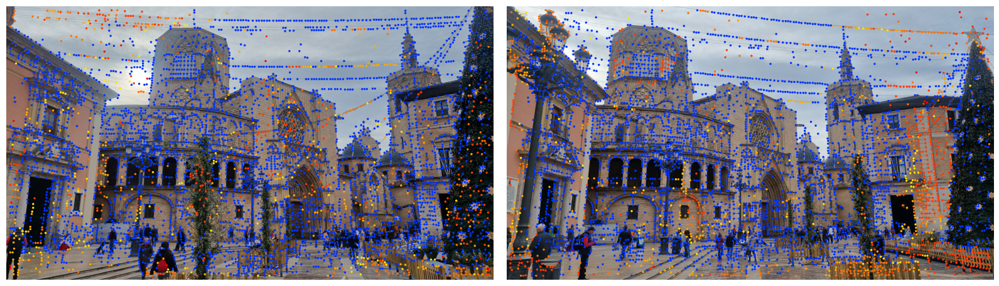

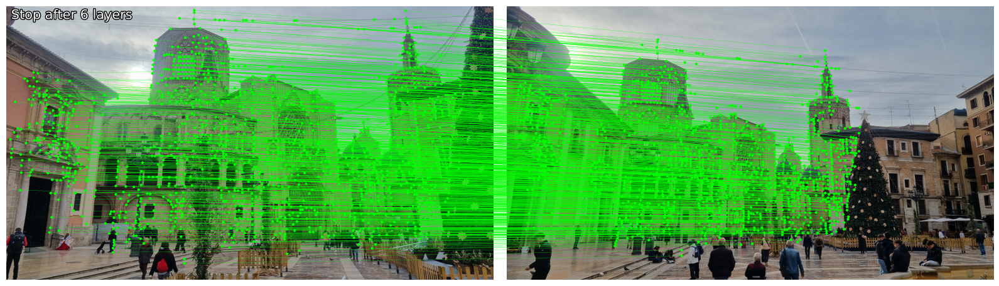

...

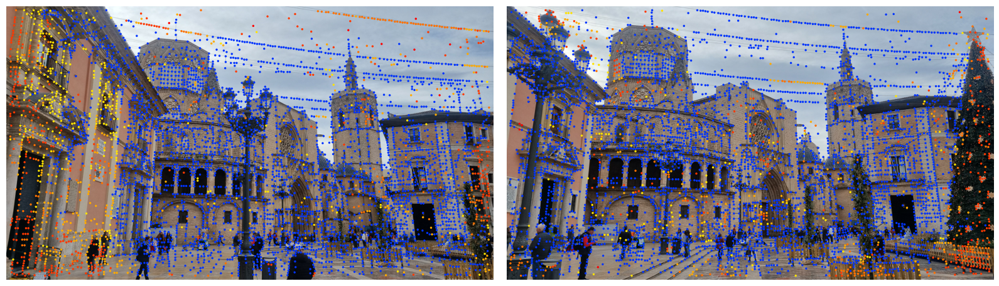

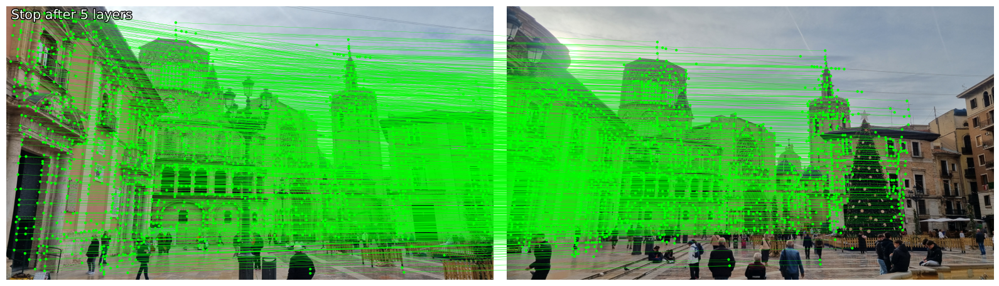

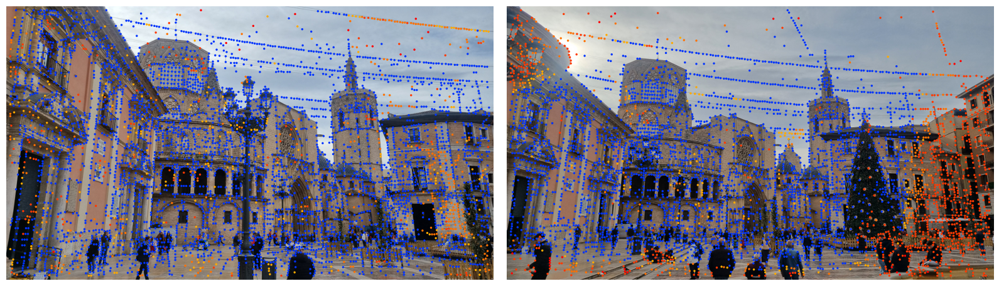

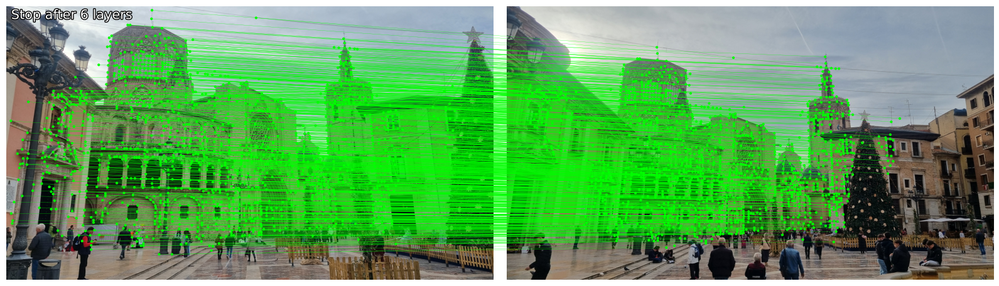

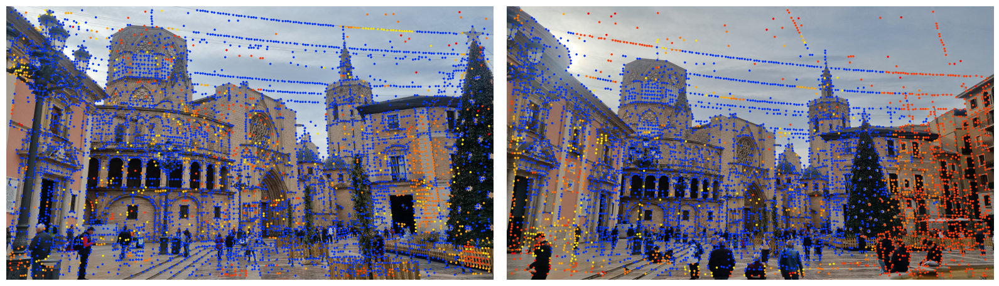

In [17]:
path_group = "./Group1"
output_path = "./matches_results/Group1_Group1"
os.makedirs(output_path, exist_ok=True)

# Obtener lista de imágenes en G1
image_files = [
    f for f in os.listdir(path_group) if f.endswith((".jpg", ".png"))
]

# Generar todas las combinaciones posibles (pares únicos)
image_combinations = itertools.combinations(image_files, 2)

# Procesar cada par de imágenes
for image1, image2 in image_combinations:
    print(f"Procesando: {image1} vs {image2}")
    
    # Cargar imágenes
    image1_path = os.path.join(path_group, image1)
    image2_path = os.path.join(path_group, image2)
    img1 = load_image(image1_path)
    img2 = load_image(image2_path)
    
    # Extraer características
    feats1 = extractor_g1.extract(img1.to(device))
    feats2 = extractor_g1.extract(img2.to(device))
    matches12 = matcher_g1({"image0": feats1, "image1": feats2})
    feats1, feats2, matches12 = [rbd(x) for x in [feats1, feats2, matches12]]
    
    # Extraer keypoints, matches y puntuaciones
    kpts1, kpts2 = feats1["keypoints"], feats2["keypoints"]
    matches = matches12["matches"]
    scores = matches12["scores"]
    
    # Guardar resultados en formato .npz
    output_file = os.path.join(
        output_path, f"{image1.split('.')[0]}_vs_{image2.split('.')[0]}_matches.npz"
    )
    np.savez(
        output_file,
        keypoints0=kpts1,
        keypoints1=kpts2,
        matches=matches,
        scores=scores
    )
    print(f"Resultados guardados en: {output_file}")
    
    # Visualización 
    print(f"Visualizando matches para: {image1} vs {image2}")
    m_kpts1, m_kpts2 = kpts1[matches[..., 0]], kpts2[matches[..., 1]]
    
    axes = viz2d.plot_images([img1, img2])
    viz2d.plot_matches(m_kpts1, m_kpts2, color="lime", lw=0.2)
    viz2d.add_text(0, f'Stop after {matches12["stop"]} layers')

    kpc1, kpc2 = viz2d.cm_prune(matches12["prune0"]), viz2d.cm_prune(matches12["prune1"])
    viz2d.plot_images([img1, img2])
    viz2d.plot_keypoints([kpts1, kpts2], colors=[kpc1, kpc2], ps=6)


## Original - Group 2

Procesando imágenes en: ./Group2
Procesando: Img23_Try1_12M.jpg


Procesando: Img24_Try1_12M.jpg
Procesando: Img15_Try3_12M.jpg


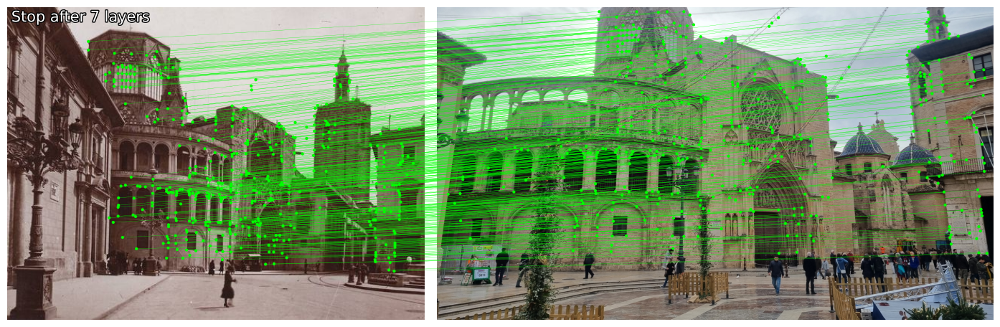

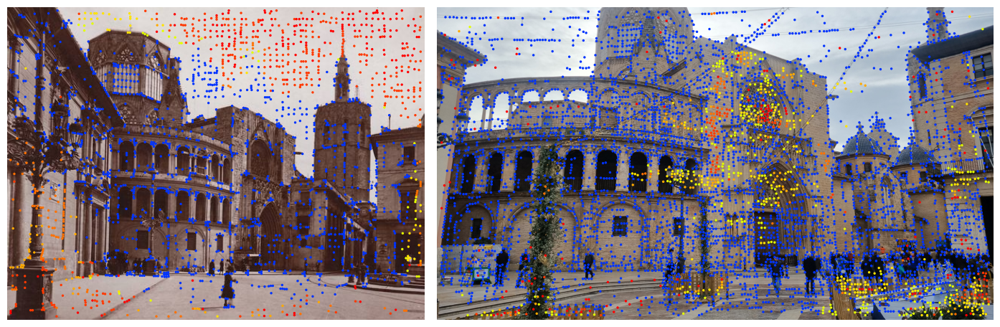

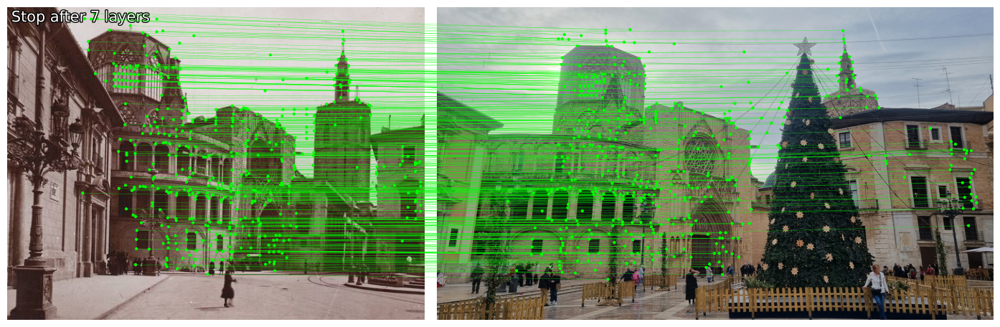

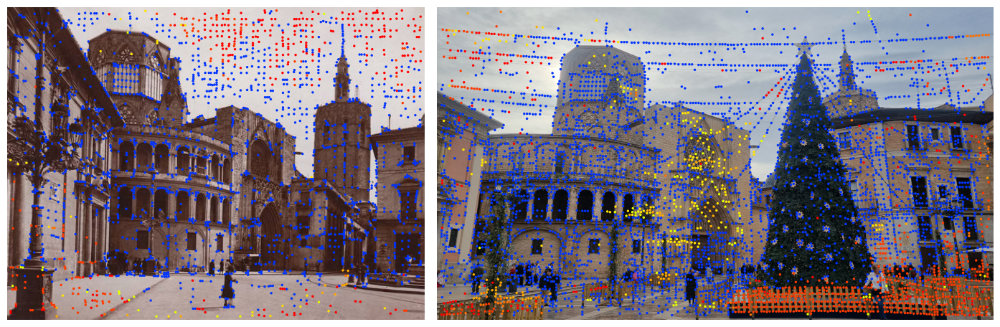

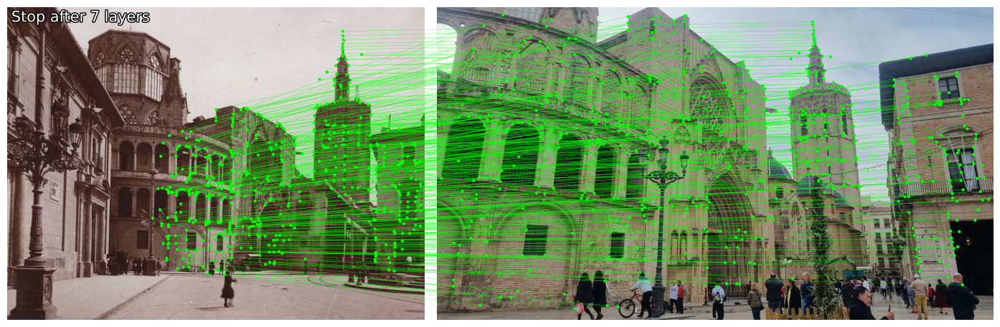

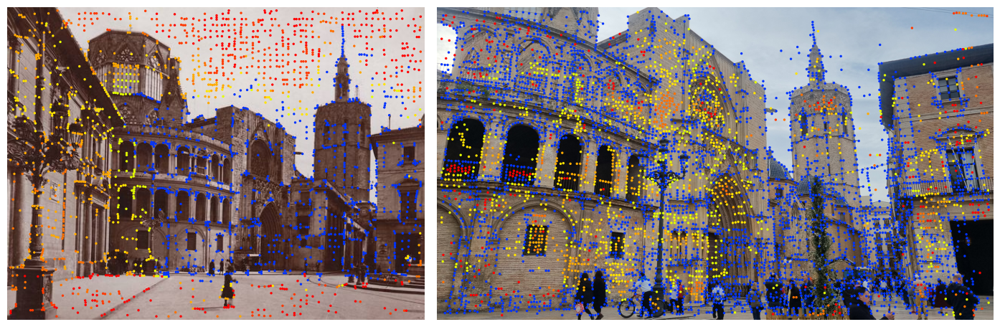

In [8]:
path_group = "./Group2" 

print("Procesando imágenes en:", path_group)
# Procesar cada imagen en Group2
for filename in os.listdir(path_group):
    if filename.endswith((".jpg", ".png")):  # Ajusta según el formato de tus imágenes
        
        print("Procesando:", filename)
        image0 = load_image("../original.jpg")
        image1 = load_image(os.path.join(path_group, filename))
        
        feats0 = extractor_g2.extract(image0.to(device))
        feats1 = extractor_g2.extract(image1.to(device))
        matches01 = matcher_g2({"image0": feats0, "image1": feats1})
        feats0, feats1, matches01 = [
            rbd(x) for x in [feats0, feats1, matches01]
        ]  # remove batch dimension

        kpts0, kpts1, matches = feats0["keypoints"], feats1["keypoints"], matches01["matches"]
        m_kpts0, m_kpts1 = kpts0[matches[..., 0]], kpts1[matches[..., 1]]

        axes = viz2d.plot_images([image0, image1])
        viz2d.plot_matches(m_kpts0, m_kpts1, color="lime", lw=0.2)
        viz2d.add_text(0, f'Stop after {matches01["stop"]} layers')

        kpc0, kpc1 = viz2d.cm_prune(matches01["prune0"]), viz2d.cm_prune(matches01["prune1"])
        viz2d.plot_images([image0, image1])
        viz2d.plot_keypoints([kpts0, kpts1], colors=[kpc0, kpc1], ps=6)
    

## Original - Group 3

In [19]:
path_group = "./Group0" 
path_group1 = "./Group1" 

image0 = load_image(os.path.join(path_group1, 'Img02_Try1_12M.jpg'))
image1 = load_image(os.path.join(path_group, 'Img00_Try1_12M.jpg'))

feats0 = extractor_g1.extract(image0.to(device))
feats1 = extractor_g1.extract(image1.to(device))
matches01 = matcher_g1({"image0": feats0, "image1": feats1})
feats0, feats1, matches01 = [
    rbd(x) for x in [feats0, feats1, matches01]
]  # remove batch dimension

kpts0, kpts1, matches = feats0["keypoints"], feats1["keypoints"], matches01["matches"]
m_kpts0, m_kpts1 = kpts0[matches[..., 0]], kpts1[matches[..., 1]]

# Guardar resultados en formato .npz
output_file = './matches_results/Group1_Group3/Img02_Try1_12M_vs_Img00_Try1_12M_matches.npz'
np.savez(output_file, keypoints0=kpts0, keypoints1=kpts1, matches=matches)
print(f"Resultados guardados en: {output_file}")


Resultados guardados en: ./matches_results/Group1_Group3/Img02_Try1_12M_vs_Img00_Try1_12M_matches.npz
